# Initial EDA (Exploratory Data Analysis)

Imported v0.1.58. After importing, execute '%matplotlib inline' to display charts in Jupyter.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Update: verbose=0 displays charts in your local Jupyter notebook.
        verbose=1 additionally provides EDA data cleaning suggestions. It also displays charts.
        verbose=2 does not display charts but saves them in AutoViz_Plots folder in local machine.
        chart_format='bokeh' displays charts in your local Jupyter notebook.
        chart_format='server' displays charts in your browser: one tab for each chart type
        chart_format='html' silently saves interactive HTML files in your local machine
Shape of your Data Set loaded: (569, 32)
#######################################################################################
######################## C L A S S I

,Nuniques,dtype,Nulls,Nullpercent,NuniquePercent,Value counts Min,Data cleaning improvement suggestions
id,569,int64,0,0.000000,100.000000,0,possible ID column: drop
smoothness_se,547,float64,0,0.000000,96.133568,0,skewed: cap or drop outliers
fractal_dimension_se,545,float64,0,0.000000,95.782074,0,skewed: cap or drop outliers
area_worst,544,float64,0,0.000000,95.606327,0,skewed: cap or drop outliers
concave points_mean,542,float64,0,0.000000,95.254833,0,skewed: cap or drop outliers
compactness_se,541,float64,0,0.000000,95.079086,0,skewed: cap or drop outliers
radius_se,540,float64,0,0.000000,94.903339,0,skewed: cap or drop outliers
concavity_worst,539,float64,0,0.000000,94.727592,0,skewed: cap or drop outliers
area_mean,539,float64,0,0.000000,94.727592,0,skewed: cap or drop outliers
compactness_mean,537,float64,0,0.000000,94.376098,0,skewed: cap or drop outliers


    32 Predictors classified...
        1 variables removed since they were ID or low-information variables
        List of variables removed: ['id']
30 numeric variables in data exceeds limit, taking top 30 variables
    List of variables selected: ['radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean', 'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean', 'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se', 'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se', 'fractal_dimension_se', 'radius_worst', 'texture_worst', 'perimeter_worst', 'area_worst', 'smoothness_worst', 'compactness_worst', 'concavity_worst', 'concave points_worst', 'symmetry_worst', 'fractal_dimension_worst']
   Total columns > 30, too numerous to print.
Number of All Scatter Plots = 465


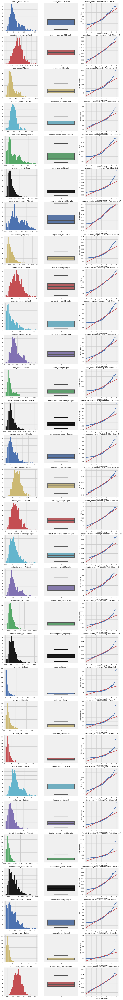

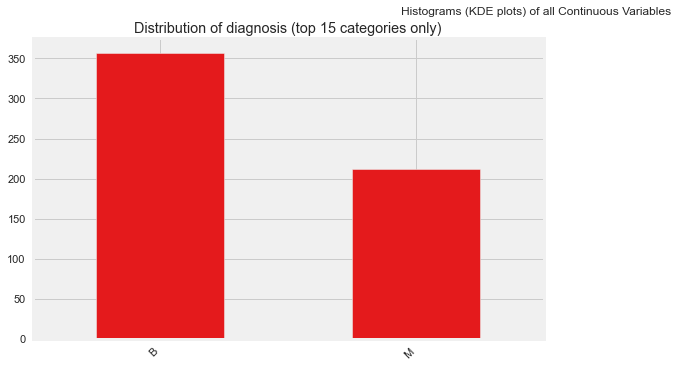

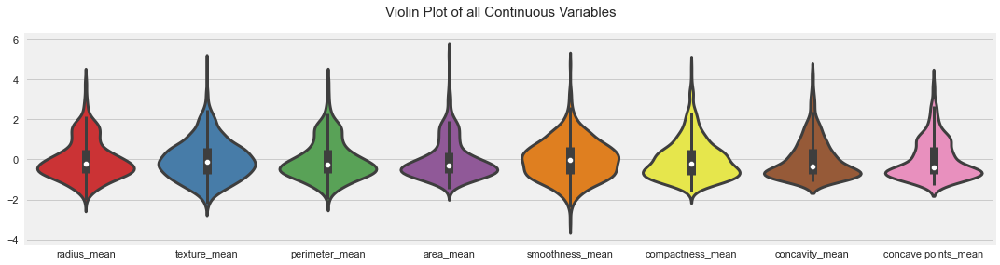

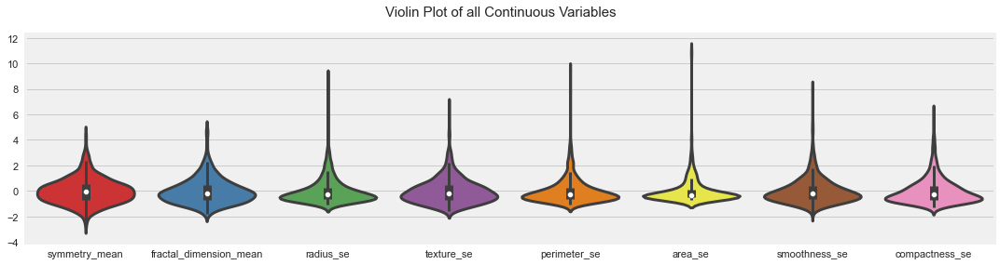

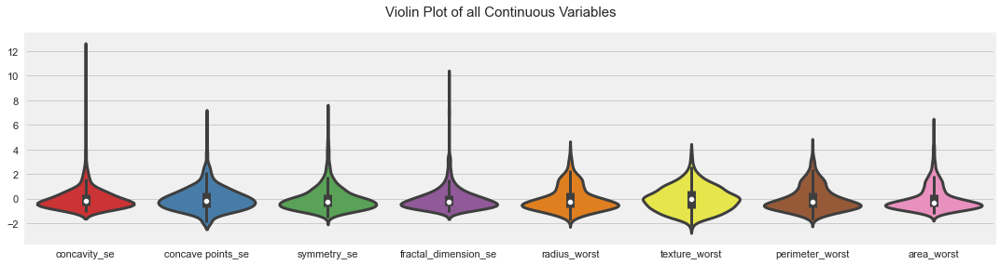

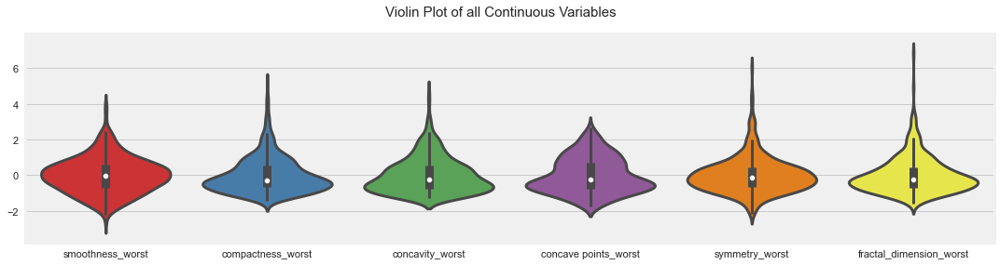

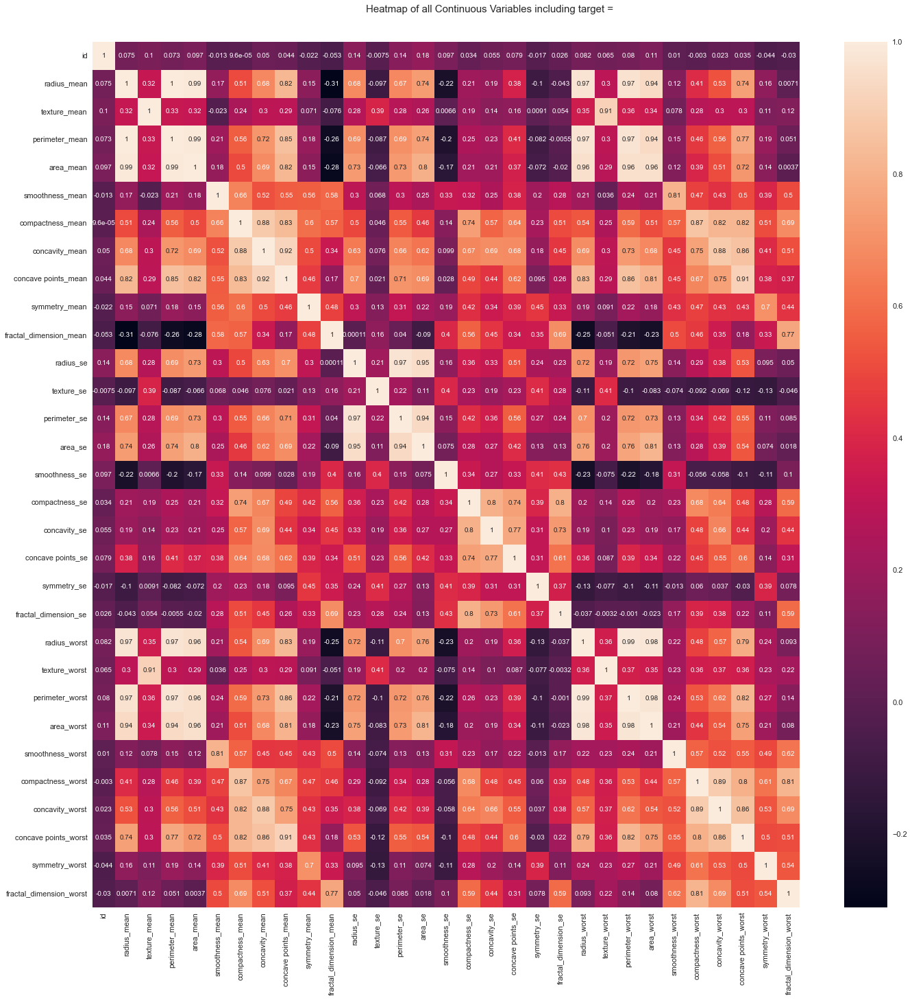

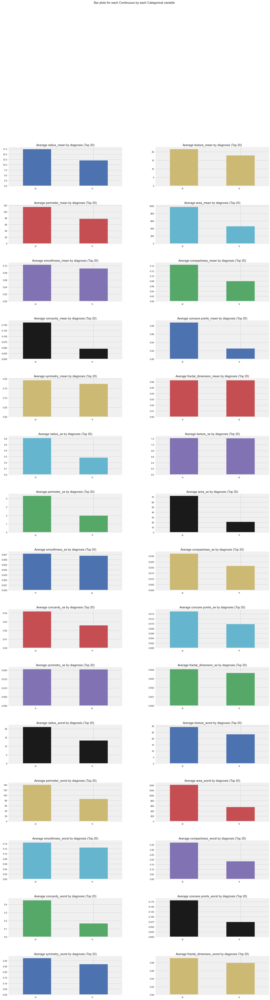

All Plots done
Time to run AutoViz = 85 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


In [1]:
from autoviz.AutoViz_Class import AutoViz_Class
%matplotlib inline
AV = AutoViz_Class()
# change the path here to your dataset path
viz = AV.AutoViz('E:/Z-Machine Learning/My Work/DataSets/Cancer Detection/data 2.csv')

# Highlights Showing important data characteristics from the EDA 

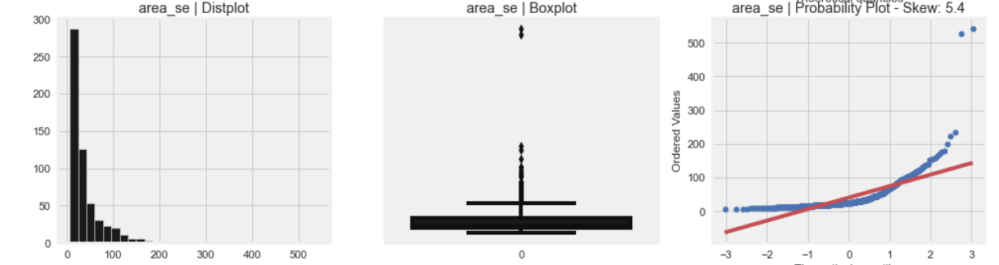

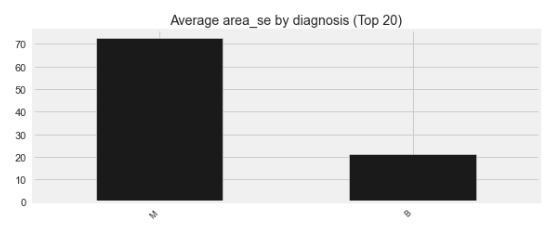

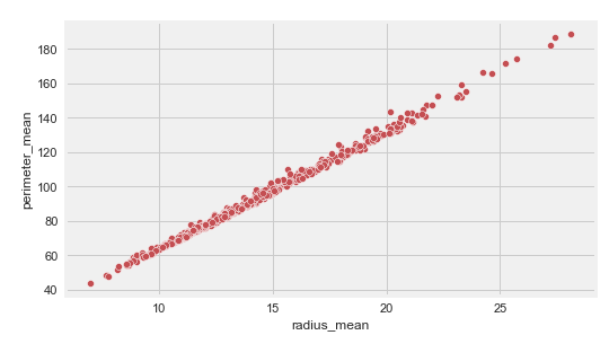 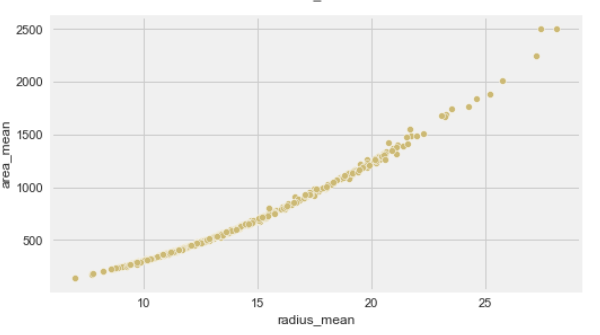

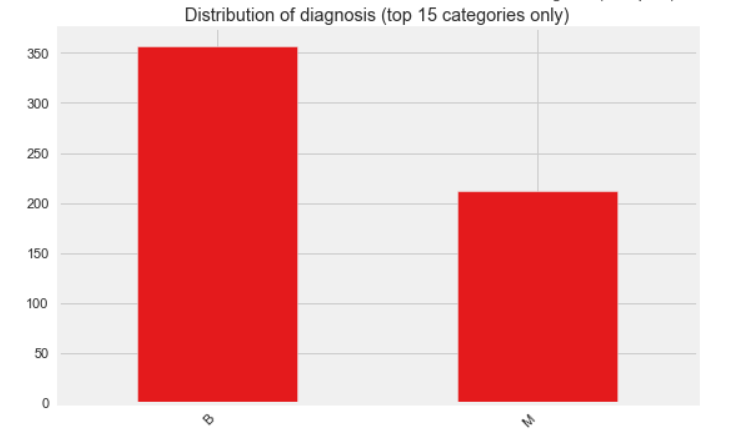

As it turns out as described from The EDA some features are highly skewed
meaning they do not follow the normal distribution and contain a good deal of outliers as Visualized from the Q_Q plot, Box-Plot and Histograms such as in the area_se above

we can also assume that the area_se plays an important role to our diagnosis and that when it's value is high we can expect the diagnosis to be M and when it's value is Low we can expect the diagnosis to be B

It also shows that some features are very highly correlated from the scatter plot such as the radius_mean with the area_mean which logically makes sense as well as for the radius_mean perimeter_mean



It also seems that our Target Variable 'Diagnosis (The Y) is quite un-balanced

In [2]:
# importing some necessary packages
import numpy as np
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt

# Reading The Dataset

In [3]:
#https://www.kaggle.com/sarahvch/breast-cancer-wisconsin-prognostic-data-set

# change the path here to your dataset path
orig_df = pd.read_csv('E:/Z-Machine Learning/My Work/DataSets/Cancer Detection/data 2.csv')

#we do this in order to keep a copy of the original dataframe without any processing or manipulations in case of need
df = orig_df.copy()
df.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [4]:
# Dropping the ID column as it won't be of much help in our problem
df = df.drop(['id'], axis=1)

#  Initial Pre-Processing

In [5]:
def encode_labels(x):
    '''
    Pass the variable you want to encode and it shall return the encoded version of it and the fitted label encoder
    the fitted label encoder is returned for any further encoding/decoding processes
    '''
    from sklearn import preprocessing
    label_encoder = preprocessing.LabelEncoder()
    label_encoder.fit(x)
    return label_encoder.transform(x), label_encoder

# Encoding Our Target the 'diagnosis' column From M and B to 1 and 0
df['diagnosis'], diagnosis_label_encoder = encode_labels(df['diagnosis'])
df.head()

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,1,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,1,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,1,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,1,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [6]:
# encoding the 'diagnosis' was done before the describing the data because the df.describe wouldn't recognize it as a string
df.describe()

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
count,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,0.372583,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,...,16.269190,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946
std,0.483918,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,...,4.833242,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061
min,0.000000,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,...,7.930000,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040
25%,0.000000,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,...,13.010000,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460
50%,0.000000,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,...,14.970000,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040
75%,1.000000,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,...,18.790000,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080
max,1.000000,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,...,36.040000,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500


In [7]:
df.head()

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,1,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,1,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,1,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,1,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [8]:
import EZML as ez
#this is my own library I used to scale my dataframe with
#for any inquires about the library please contact me via Email, Linked-In or Github
#it performes simple MinMaxScaler with the default parameters
df = ez.scale_data(df)

# Initial Models Training and Testing

In [9]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(np.array(df.drop(['diagnosis'], axis=1)), np.array(df['diagnosis']), test_size=0.2)

In [10]:
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier

In [11]:
logistic_regression_model = LogisticRegression()
logistic_regression_model.fit(x_train, y_train)
logistic_regression_model.score(x_train, y_train), logistic_regression_model.score(x_test, y_test)

(0.9692307692307692, 0.956140350877193)

In [12]:
SVM_model = SVC()
SVM_model.fit(x_train, y_train)
SVM_model.score(x_train, y_train), SVM_model.score(x_test, y_test)

(0.9802197802197802, 0.9824561403508771)

In [13]:
random_forest_model = RandomForestClassifier(n_estimators = 1_000, max_depth=20, random_state=0)
random_forest_model.fit(x_train, y_train)
random_forest_model.score(x_train, y_train), random_forest_model.score(x_test, y_test)

(1.0, 0.956140350877193)

In [14]:
def plot_precision_recall_curve(y_true, y_predicted_probabilities):
    from sklearn.metrics import precision_recall_curve
    #calculate precision and recall
    precision, recall, thresholds = precision_recall_curve(y_true, y_predicted_probabilities)

    #create precision recall curve
    fig, ax = plt.subplots()
    ax.plot(recall, precision, color='purple')

    #add axis labels to plot
    ax.set_title('Precision-Recall Curve')
    ax.set_ylabel('Precision')
    ax.set_xlabel('Recall')

    #display plot
    plt.show()

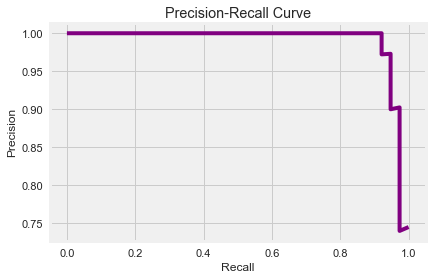

In [15]:
plot_precision_recall_curve(y_test, logistic_regression_model.predict_proba(x_test)[:, 1])

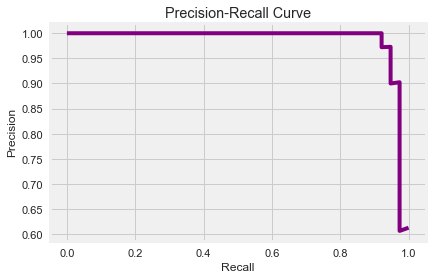

In [16]:
plot_precision_recall_curve(y_test, random_forest_model.predict_proba(x_test)[:, 1])

In [17]:
logistic_regression_test_predictions = logistic_regression_model.predict(x_test)
SVM_test_predictions = SVM_model.predict(x_test)
random_forest_test_predictions = random_forest_model.predict(x_test)

In [18]:
def get_model_scores(y_true, y_predicted):
    from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score
    print('accuracy is ', '%.4f'  %accuracy_score(y_test, y_predicted))
    print('F1_Score is ', '%.4f'  %f1_score(y_test, y_predicted))
    print('precission_Score is ', '%.4f'  %precision_score(y_test, y_predicted))
    print('recall_Score is ', '%.4f'  %recall_score(y_test, y_predicted))
        

In [19]:
get_model_scores(y_test, logistic_regression_test_predictions)

accuracy is  0.9561
F1_Score is  0.9296
precission_Score is  1.0000
recall_Score is  0.8684


In [20]:
get_model_scores(y_test, SVM_test_predictions)

accuracy is  0.9825
F1_Score is  0.9730
precission_Score is  1.0000
recall_Score is  0.9474


In [21]:
get_model_scores(y_test, random_forest_test_predictions)

accuracy is  0.9561
F1_Score is  0.9296
precission_Score is  1.0000
recall_Score is  0.8684


# Seems that the 3 Previous Classifiers are performing well
# We'll Try running a neural network model to see if there's any differences or insights that may be gained

In [22]:
#================================================ 
class CustomCallback(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        keys = list(logs.keys())
        if(float(logs.get('acc')) >= 9 and float(logs.get('val_acc')) >= 0.9737):
            print('')
            print('')
            print('Training is stopped because ')
            print('the accuracy is ', float(logs.get('acc')) , 'and the val_acc is ', float(logs.get('val_acc')) )
            self.model.stop_training = True

In [23]:
deep_model = tf.keras.Sequential([
    tf.keras.layers.Flatten(input_shape=(x_train.shape[1:])),
    tf.keras.layers.Dense(100, activation='relu'),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dense(1, activation='sigmoid'),
])
deep_model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001), loss='binary_crossentropy', metrics=['acc'])  
hist = deep_model.fit(x_train, y_train, epochs=100, batch_size=8,
                      validation_data=(x_test, y_test), callbacks=[CustomCallback()])

Epoch 1/100
57/57 [==============================] - 1s 7ms/step - loss: 0.5767 - acc: 0.7077 - val_loss: 0.4244 - val_acc: 0.8772
Epoch 2/100
57/57 [==============================] - 0s 4ms/step - loss: 0.3316 - acc: 0.8967 - val_loss: 0.2606 - val_acc: 0.9123
Epoch 3/100
57/57 [==============================] - 0s 4ms/step - loss: 0.2165 - acc: 0.9187 - val_loss: 0.1861 - val_acc: 0.9123
Epoch 4/100
57/57 [==============================] - 0s 4ms/step - loss: 0.1806 - acc: 0.9363 - val_loss: 0.1613 - val_acc: 0.9298
Epoch 5/100
57/57 [==============================] - 0s 5ms/step - loss: 0.1408 - acc: 0.9407 - val_loss: 0.1378 - val_acc: 0.9386
Epoch 6/100
57/57 [==============================] - 0s 5ms/step - loss: 0.1310 - acc: 0.9516 - val_loss: 0.1535 - val_acc: 0.9298
Epoch 7/100
57/57 [==============================] - 0s 5ms/step - loss: 0.1063 - acc: 0.9670 - val_loss: 0.1293 - val_acc: 0.9474
Epoch 8/100
57/57 [==============================] - 0s 5ms/step - loss: 0.1028 - a

57/57 [==============================] - 0s 5ms/step - loss: 0.0244 - acc: 0.9934 - val_loss: 0.1950 - val_acc: 0.9561
Epoch 64/100
57/57 [==============================] - 0s 6ms/step - loss: 0.0233 - acc: 0.9912 - val_loss: 0.2193 - val_acc: 0.9737
Epoch 65/100
57/57 [==============================] - 0s 5ms/step - loss: 0.0253 - acc: 0.9868 - val_loss: 0.2168 - val_acc: 0.9561
Epoch 66/100
57/57 [==============================] - 0s 5ms/step - loss: 0.0230 - acc: 0.9912 - val_loss: 0.2075 - val_acc: 0.9474
Epoch 67/100
57/57 [==============================] - 0s 5ms/step - loss: 0.0155 - acc: 0.9956 - val_loss: 0.2229 - val_acc: 0.9474
Epoch 68/100
57/57 [==============================] - 0s 6ms/step - loss: 0.0231 - acc: 0.9934 - val_loss: 0.2255 - val_acc: 0.9474
Epoch 69/100
57/57 [==============================] - 0s 6ms/step - loss: 0.0231 - acc: 0.9890 - val_loss: 0.2105 - val_acc: 0.9561
Epoch 70/100
57/57 [==============================] - 0s 6ms/step - loss: 0.0195 - acc: 0

From many Trials of this notebook it seems that the neural network can either score as well as a random forst model or it may even score worse than the classical models avilable.

This may be due to that the neural networks can easily overfit this dataset and the limited data avilable that don't even exceed 600 records

# It appears that most models Score very well without performing any feature Selection and Dimensionality Reduction

# Let's check the impact of performing Dimensionality Reduction on the same Models

In [24]:
# from the above data visualization it seems we can use the radius_mean to know the area_mean and the perimeter_mean
#since they are highly correlated
# Dropping the ID column as it won't be of much help in our problem
df = df.drop(['perimeter_mean', 'area_mean'], axis=1)

In [25]:
def Display_Cumulative_variance_pca_components(scaled_x):
    from sklearn.decomposition import PCA
    from sklearn.preprocessing import StandardScaler
    #
    # Instantiate PCA
    #
    pca = PCA()
    #
    # Determine transformed features
    #
    X_train_pca = pca.fit_transform(scaled_x)
    #
    # Determine explained variance using explained_variance_ration_ attribute
    #
    exp_var_pca = pca.explained_variance_ratio_
    #
    # Cumulative sum of eigenvalues; This will be used to create step plot
    # for visualizing the variance explained by each principal component.
    #
    cum_sum_eigenvalues = np.cumsum(exp_var_pca)
    #
    # Create the visualization plot
    #
    plt.bar(range(0,len(exp_var_pca)), exp_var_pca, alpha=0.5, align='center', label='Individual explained variance')
    plt.step(range(0,len(cum_sum_eigenvalues)), cum_sum_eigenvalues, where='mid',label='Cumulative explained variance')
    plt.ylabel('Explained variance ratio')
    plt.xlabel('Principal component index')
    plt.legend(loc='best')
    plt.tight_layout()
    plt.show()

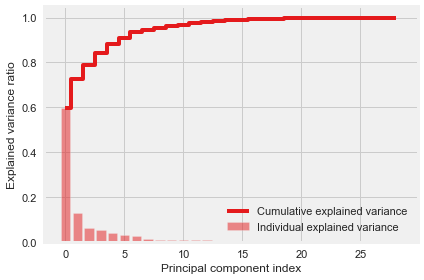

In [26]:
Display_Cumulative_variance_pca_components(df)

From this PCA Expalined Variance Graph it seems that 10 features will be sufficiently enough to grab hold of most of the variance in the data

Therefore we will be reducing our dataframe to only 10 PCA components

In [27]:
#visualizing the most important features for the top 10 Principle Components
from pca import pca
model = pca(n_components=10)
# Fit transform
out = model.fit_transform(df.drop(['diagnosis'], axis=1))
# Print the top features.
print(out['topfeat'])

[pca] >Processing dataframe..
[pca] >The PCA reduction is performed on the [28] columns of the input dataframe.
[pca] >Fit using PCA.
[pca] >Compute loadings and PCs.
[pca] >Compute explained variance.
[pca] >Outlier detection using Hotelling T2 test with alpha=[0.05] and n_components=[10]
[pca] >Outlier detection using SPE/DmodX with n_std=[2]
      PC                  feature   loading  type
0    PC1     concave points_worst  0.393939  best
1    PC2   fractal_dimension_mean  0.427792  best
2    PC3            texture_worst  0.652196  best
3    PC4              symmetry_se  0.319823  best
4    PC5         smoothness_worst -0.418068  best
5    PC6           symmetry_worst  0.546666  best
6    PC7        concave points_se -0.397491  best
7    PC8            smoothness_se  0.458507  best
8    PC9               texture_se  0.497004  best
9   PC10          concavity_worst  0.454795  best
10   PC2              radius_mean -0.317018  weak
11   PC3             texture_mean  0.588428  weak
12 

In [28]:
def pca_reduction(x, n_components):
    from sklearn.decomposition import PCA
    pca = PCA(n_components=n_components)
    pca.fit(x)
    x_pca = pca.transform(x)
    return x_pca, pca
# Applying principle component analysis for dimmensionality reduction.
x_train_PCA, pca_object = pca_reduction(x_train, 10)
x_test_PCA = pca_object.transform(x_test)

In [29]:
logistic_regression_model_PCA = LogisticRegression()
logistic_regression_model_PCA.fit(x_train_PCA, y_train)
logistic_regression_model_PCA.score(x_train_PCA, y_train), logistic_regression_model_PCA.score(x_test_PCA, y_test)

(0.9692307692307692, 0.956140350877193)

In [30]:
SVM_model_PCA = SVC()
SVM_model_PCA.fit(x_train_PCA, y_train)
SVM_model_PCA.score(x_train_PCA, y_train), SVM_model_PCA.score(x_test_PCA, y_test)

(0.9802197802197802, 0.9824561403508771)

In [31]:
random_forest_model_PCA = RandomForestClassifier(n_estimators = 1_000, max_depth=20, random_state=0)
random_forest_model_PCA.fit(x_train_PCA, y_train)
random_forest_model_PCA.score(x_train_PCA, y_train), random_forest_model_PCA.score(x_test_PCA, y_test)

(1.0, 0.9473684210526315)

In [32]:
logistic_regression_PCA_test_predictions = logistic_regression_model_PCA.predict(x_test_PCA)
SVM_PCA_test_predictions = SVM_model_PCA.predict(x_test_PCA)
random_forest_PCA_test_predictions = random_forest_model_PCA.predict(x_test_PCA)

In [33]:
get_model_scores(y_test, logistic_regression_PCA_test_predictions)

accuracy is  0.9561
F1_Score is  0.9296
precission_Score is  1.0000
recall_Score is  0.8684


In [34]:
get_model_scores(y_test, SVM_PCA_test_predictions)

accuracy is  0.9825
F1_Score is  0.9730
precission_Score is  1.0000
recall_Score is  0.9474


In [35]:
get_model_scores(y_test, random_forest_PCA_test_predictions)

accuracy is  0.9474
F1_Score is  0.9167
precission_Score is  0.9706
recall_Score is  0.8684


In [36]:
#================================================ 
class CustomCallback(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        keys = list(logs.keys())
        if(float(logs.get('acc')) >= 0.99 and float(logs.get('val_acc')) >= 0.9737):
            print('')
            print('')
            print('Training is stopped because ')
            print('the accuracy is ', float(logs.get('acc')) , 'and the val_acc is ', float(logs.get('val_acc')) )
            self.model.stop_training = True

In [37]:
deep_model_PCA = tf.keras.Sequential([
    tf.keras.layers.Flatten(input_shape=(x_train_PCA.shape[1:])),
    tf.keras.layers.Dense(100, activation='relu'),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dense(1, activation='sigmoid'),
])
deep_model_PCA.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001), loss='binary_crossentropy', metrics=['acc'])  
hist = deep_model_PCA.fit(x_train_PCA, y_train, epochs=100, batch_size=8,
                      validation_data=(x_test_PCA, y_test), callbacks=[CustomCallback()])

Epoch 1/100
57/57 [==============================] - 1s 7ms/step - loss: 0.4806 - acc: 0.8747 - val_loss: 0.2750 - val_acc: 0.9298
Epoch 2/100
57/57 [==============================] - 0s 6ms/step - loss: 0.1800 - acc: 0.9516 - val_loss: 0.1283 - val_acc: 0.9737
Epoch 3/100
57/57 [==============================] - 0s 5ms/step - loss: 0.1033 - acc: 0.9714 - val_loss: 0.0892 - val_acc: 0.9737
Epoch 4/100
57/57 [==============================] - 0s 6ms/step - loss: 0.0801 - acc: 0.9824 - val_loss: 0.0816 - val_acc: 0.9825
Epoch 5/100
57/57 [==============================] - 0s 6ms/step - loss: 0.0719 - acc: 0.9824 - val_loss: 0.0689 - val_acc: 0.9737
Epoch 6/100
57/57 [==============================] - 0s 6ms/step - loss: 0.0698 - acc: 0.9824 - val_loss: 0.0642 - val_acc: 0.9737
Epoch 7/100
57/57 [==============================] - 0s 5ms/step - loss: 0.0628 - acc: 0.9824 - val_loss: 0.0650 - val_acc: 0.9737
Epoch 8/100
57/57 [==============================] - 0s 8ms/step - loss: 0.0583 - a

In [38]:
#get the model test predictions
deep_model_PCA_test_predictions = deep_model_PCA.predict(x_test_PCA)

#this line is done because the model only outputs the predictions as probabilities and not discret values
deep_model_PCA_test_predictions_processed = [round(i[0]) for i in deep_model_PCA_test_predictions]
deep_model_PCA_test_predictions_processed[0:5]

[0, 0, 0, 0, 0]

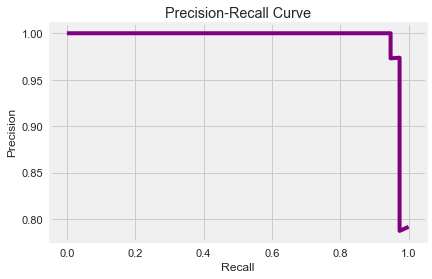

In [39]:
plot_precision_recall_curve(y_test, deep_model_PCA_test_predictions)

In [40]:
get_model_scores(y_test, deep_model_PCA_test_predictions_processed)

accuracy is  0.9825
F1_Score is  0.9730
precission_Score is  1.0000
recall_Score is  0.9474


In [41]:
def plot_ROC_curve(y_true, y_predicted_probabilities):
    #define metrics
    from sklearn.metrics import roc_curve
    false_positive_rate, true_postitive_rate, _ = roc_curve(y_true,  y_predicted_probabilities)

    #create ROC curve
    plt.plot(false_positive_rate, true_postitive_rate)
    plt.ylabel('True Positive Rate')
    plt.xlabel('False Positive Rate')
    plt.show()

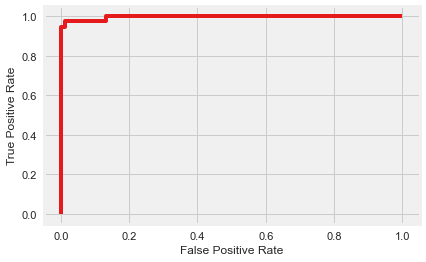

In [42]:
plot_ROC_curve(y_test, deep_model_PCA_test_predictions)

In Conclusion
Despite the unbalance in the data and the degree of the skewness, classical machine learning approaches such as Logistic Regression, SVM and the ensemble approach of the random forest model proved to outperform the deep learning model before performing dimmensionality reduction

what is surprising is that after performing dimmensionality reduction the neural network was able to produc a better fit than the classical approaches although the classical approach thrive when the in low number of features rather than too many features and the neural network thrives when there are too many features rather than few features but this was not the case on this dataset

this could be a few observations
the data doesn't contain a lot of records and a little less than 600 records
the target "diagnoisis" imbalance probably wasn't a huge problem to intreperet by the models due to exisiting outliers in the dataset features that corresponded with the output label in an obvious manner such as the area_se.